## Visualize Feature Map

In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import os
os.environ["CUDA_VISIBLE_DEVICES"]="0"

In [3]:
import os
import fnmatch
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import backend as K
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications import Xception
from tensorflow.keras.applications.xception import preprocess_input
from tensorflow.keras import utils, models, layers

from matplotlib import pyplot as plt
from IPython.display import Image, display

from skimage import io

In [4]:
dir_img = "../subset_stanford_online_products/bicycle_final/"

In [5]:
fimages = os.listdir(dir_img)
fimages[:3]

['400931080828_7.JPG', '321820322214_3.JPG', '161777354031_4.JPG']

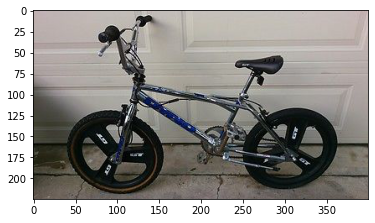

In [6]:
img_path = os.path.join(dir_img, fimages[2])
img = io.imread(img_path)
plt.imshow(img)

In [7]:
img = image.load_img(img_path, target_size=(299, 299, 3))
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)
img_tensor = preprocess_input(img_tensor)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


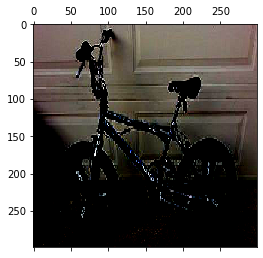

In [8]:
plt.matshow(img_tensor[0])
plt.show()

In [9]:
model = Xception(include_top=False, weights=None, input_shape=(299, 299, 3))
model.summary()

Model: "xception"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 149, 149, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 149, 149, 32) 128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 149, 149, 32) 0           block1_conv1_bn[0][0]            
___________________________________________________________________________________________

In [10]:
dict_layer_name = dict()
idx = 0
for layer in model.layers:
    dict_layer_name[str(idx)] = layer.name
    idx += 1

dict_layer_name

{'0': 'input_1',
 '1': 'block1_conv1',
 '2': 'block1_conv1_bn',
 '3': 'block1_conv1_act',
 '4': 'block1_conv2',
 '5': 'block1_conv2_bn',
 '6': 'block1_conv2_act',
 '7': 'block2_sepconv1',
 '8': 'block2_sepconv1_bn',
 '9': 'block2_sepconv2_act',
 '10': 'block2_sepconv2',
 '11': 'block2_sepconv2_bn',
 '12': 'conv2d',
 '13': 'block2_pool',
 '14': 'batch_normalization',
 '15': 'add',
 '16': 'block3_sepconv1_act',
 '17': 'block3_sepconv1',
 '18': 'block3_sepconv1_bn',
 '19': 'block3_sepconv2_act',
 '20': 'block3_sepconv2',
 '21': 'block3_sepconv2_bn',
 '22': 'conv2d_1',
 '23': 'block3_pool',
 '24': 'batch_normalization_1',
 '25': 'add_1',
 '26': 'block4_sepconv1_act',
 '27': 'block4_sepconv1',
 '28': 'block4_sepconv1_bn',
 '29': 'block4_sepconv2_act',
 '30': 'block4_sepconv2',
 '31': 'block4_sepconv2_bn',
 '32': 'conv2d_2',
 '33': 'block4_pool',
 '34': 'batch_normalization_2',
 '35': 'add_2',
 '36': 'block5_sepconv1_act',
 '37': 'block5_sepconv1',
 '38': 'block5_sepconv1_bn',
 '39': 'block5

In [11]:
layer_outputs = [layer.output for layer in model.layers[:101]]
layer_outputs

[<tf.Tensor 'input_1:0' shape=(None, 299, 299, 3) dtype=float32>,
 <tf.Tensor 'block1_conv1/Identity:0' shape=(None, 149, 149, 32) dtype=float32>,
 <tf.Tensor 'block1_conv1_bn/Identity:0' shape=(None, 149, 149, 32) dtype=float32>,
 <tf.Tensor 'block1_conv1_act/Identity:0' shape=(None, 149, 149, 32) dtype=float32>,
 <tf.Tensor 'block1_conv2/Identity:0' shape=(None, 147, 147, 64) dtype=float32>,
 <tf.Tensor 'block1_conv2_bn/Identity:0' shape=(None, 147, 147, 64) dtype=float32>,
 <tf.Tensor 'block1_conv2_act/Identity:0' shape=(None, 147, 147, 64) dtype=float32>,
 <tf.Tensor 'block2_sepconv1/Identity:0' shape=(None, 147, 147, 128) dtype=float32>,
 <tf.Tensor 'block2_sepconv1_bn/Identity:0' shape=(None, 147, 147, 128) dtype=float32>,
 <tf.Tensor 'block2_sepconv2_act/Identity:0' shape=(None, 147, 147, 128) dtype=float32>,
 <tf.Tensor 'block2_sepconv2/Identity:0' shape=(None, 147, 147, 128) dtype=float32>,
 <tf.Tensor 'block2_sepconv2_bn/Identity:0' shape=(None, 147, 147, 128) dtype=float32>,

In [12]:
activation_model = keras.Model(inputs=model.input, outputs=layer_outputs)
activation_model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 149, 149, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 149, 149, 32) 128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 149, 149, 32) 0           block1_conv1_bn[0][0]            
______________________________________________________________________________________________

In [13]:
activations = activation_model.predict(img_tensor)

In [14]:
first_layer_activation = activations[0]
print(first_layer_activation.shape)

(1, 299, 299, 3)


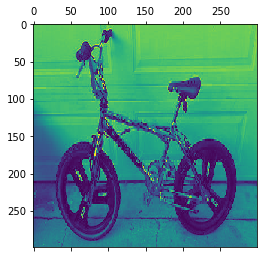

In [15]:
plt.matshow(first_layer_activation[0, :, :, :1], cmap='viridis')
plt.show()

/home/juan/miniconda3/envs/tf21/lib/python3.7/site-packages/ipykernel_launcher.py:40: UserWarning: Attempting to set identical bottom == top == -0.5 results in singular transformations; automatically expanding.
/home/juan/miniconda3/envs/tf21/lib/python3.7/site-packages/ipykernel_launcher.py:37: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/home/juan/miniconda3/envs/tf21/lib/python3.7/site-packages/matplotlib/tight_bbox.py:71: RuntimeWarning: divide by zero encountered in double_scalars
  fig.patch.set_bounds(x0 / w1, y0 / h1,
/home/juan/miniconda3/envs/tf21/lib/python3.7/site-packages/matplotlib/tight_bbox.py:72: RuntimeWarning: divide by zero encountered in double_scalars
  fig.bbox.width / w1, fig.bbox.height / h1)
/home/juan/miniconda3/envs/tf21/lib/python3.7/si

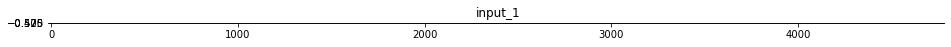

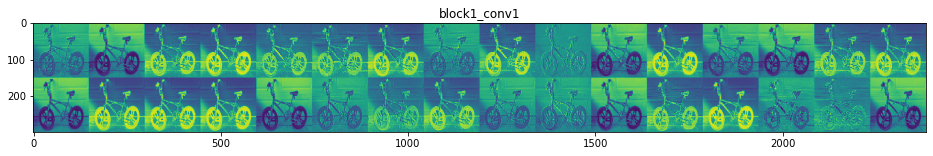

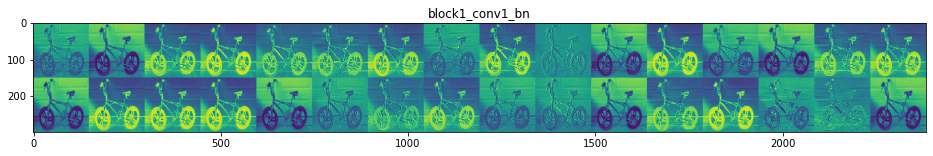

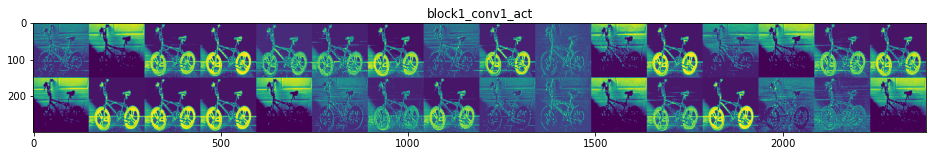

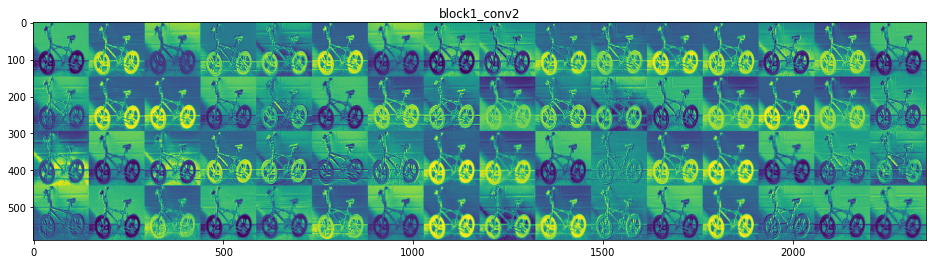

...

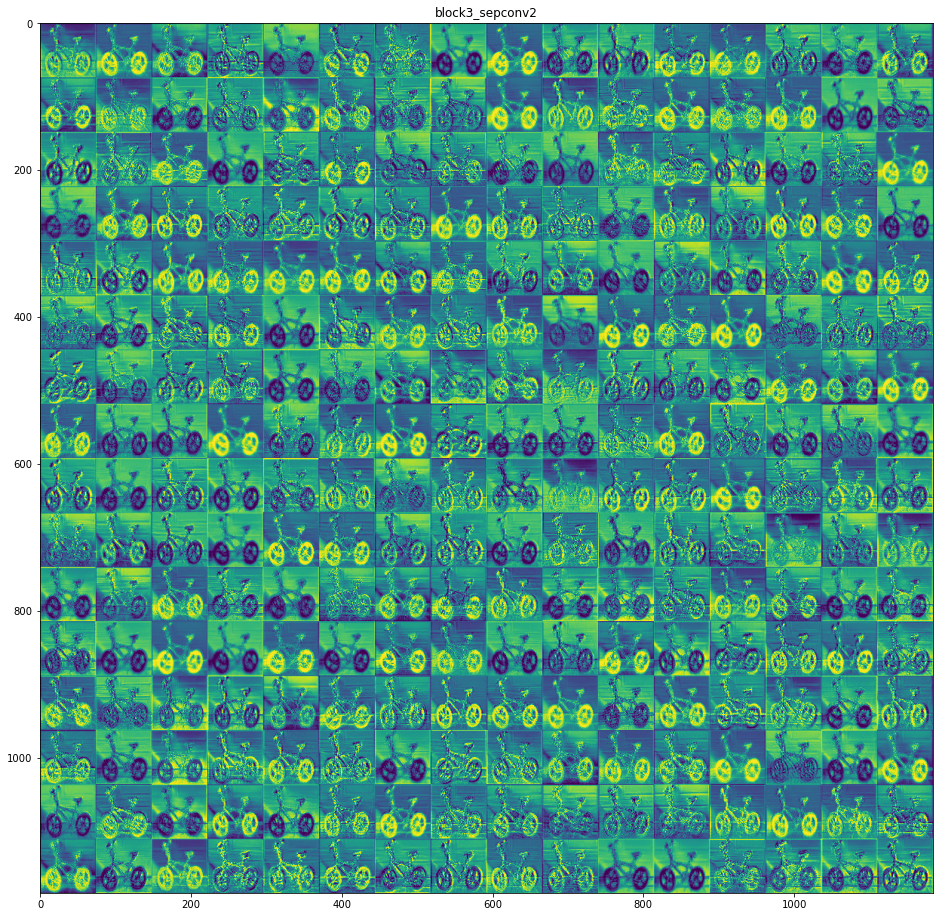

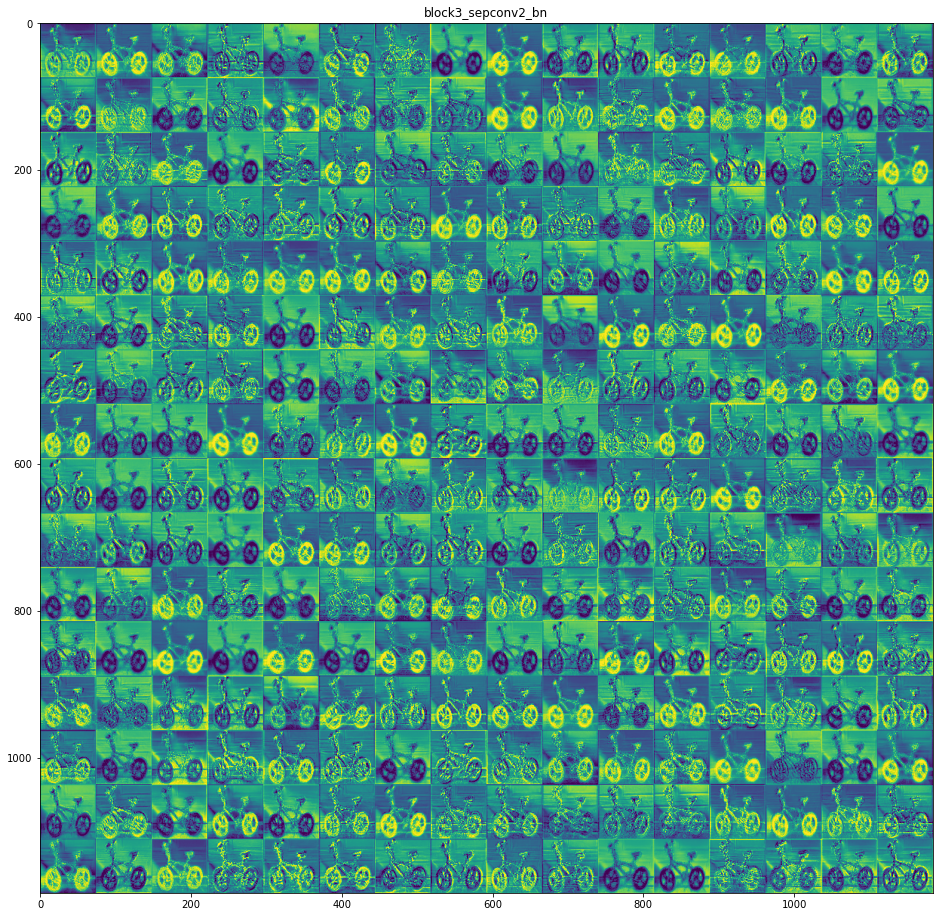

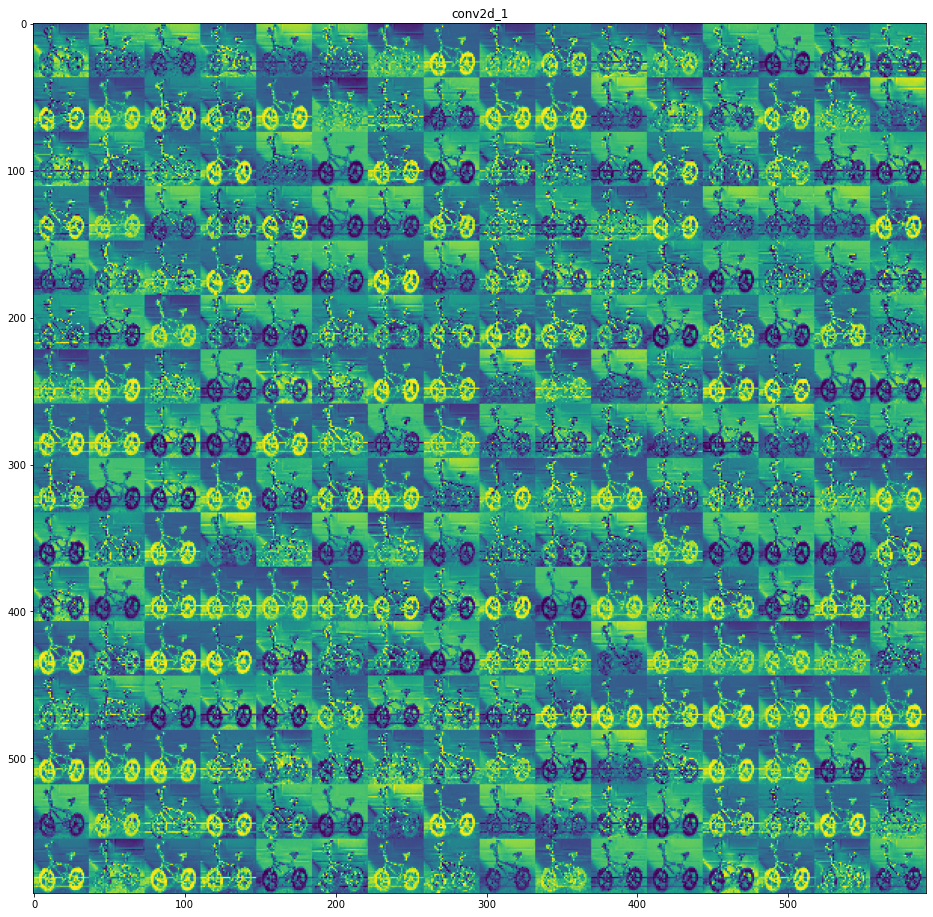

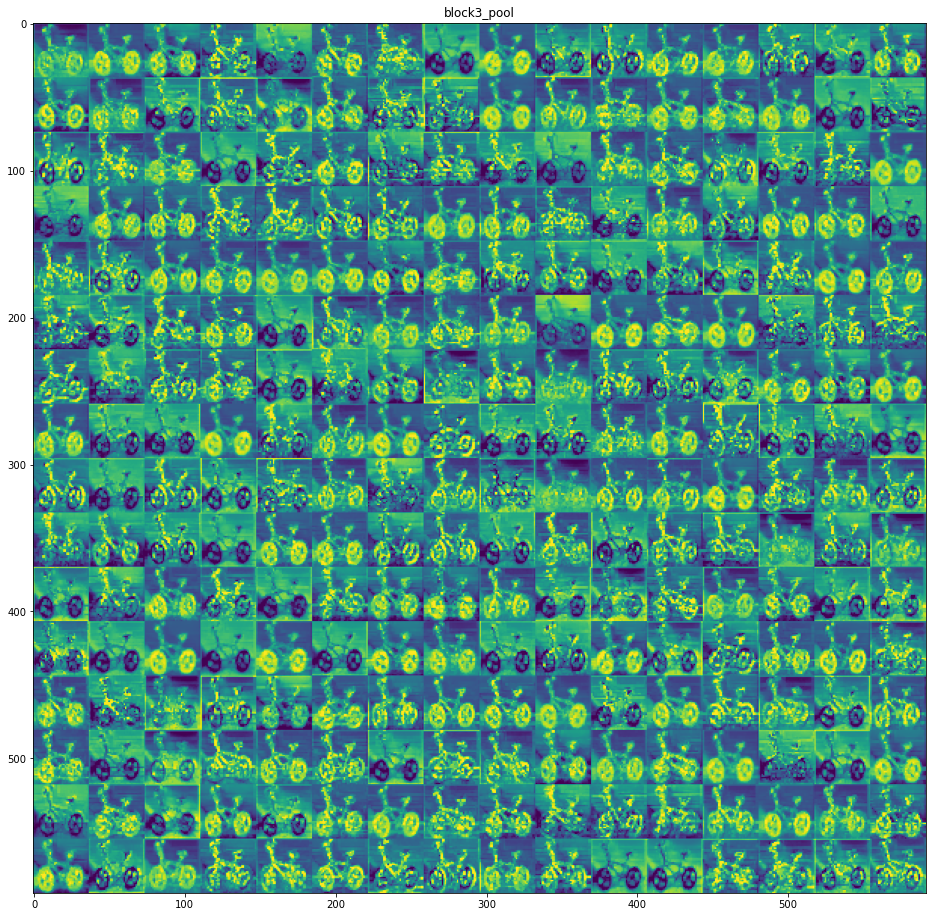

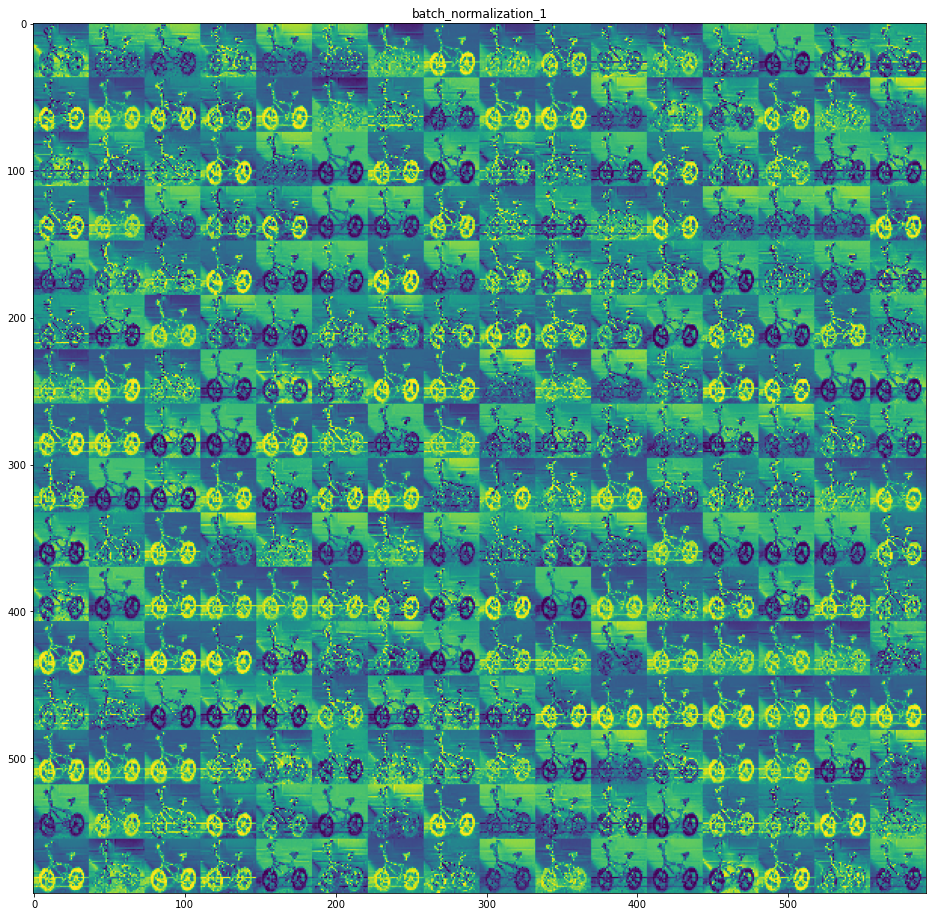

In [16]:
# These are the names of the layers, so can have them as part of our plot
layer_names = []
for layer in model.layers[:25]:
    layer_names.append(layer.name)

images_per_row = 16

# Now let's display our feature maps
for layer_name, layer_activation in zip(layer_names, activations):
    # This is the number of features in the feature map
    n_features = layer_activation.shape[-1]

    # The feature map has shape (1, size, size, n_features)
    size = layer_activation.shape[1]

    # We will tile the activation channels in this matrix
    n_cols = n_features // images_per_row
    display_grid = np.zeros((size * n_cols, images_per_row * size))

    # We'll tile each filter into this big horizontal grid
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0, :, :,
                                             col * images_per_row + row]
            # Post-process the feature to make it visually palatable
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size:(col + 1) * size,
                         row * size:(row + 1) * size] = channel_image

    # Display the grid
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')

plt.show()

## Visualize Kernel

In [17]:
layer_name = 'add'
img_width = 299
img_height = 299
layer = model.get_layer(name=layer_name)
feature_extractor = keras.Model(inputs=model.inputs, outputs=layer.output)
feature_extractor.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 149, 149, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 149, 149, 32) 128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 149, 149, 32) 0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

In [18]:
def compute_loss(input_image, filter_index):
    activation = feature_extractor(input_image)
    # We avoid border artifacts by only involving non-border pixels in the loss.
    filter_activation = activation[:, 2:-2, 2:-2, filter_index]
    return tf.reduce_mean(filter_activation)

In [19]:
@tf.function
def gradient_ascent_step(img, filter_index, learning_rate):
    with tf.GradientTape() as tape:
        tape.watch(img)
        loss = compute_loss(img, filter_index)
    # Compute gradients.
    grads = tape.gradient(loss, img)
    # Normalize gradients.
    grads = tf.math.l2_normalize(grads)
    img += learning_rate * grads
    return loss, img

In [20]:
def initialize_image():
    # We start from a gray image with some random noise
    img = tf.random.uniform((1, img_width, img_height, 3))
    #     img = image.load_img(img_path, target_size=(299, 299, 3))
    #     img_tensor = image.img_to_array(img)
    #     img_tensor = np.expand_dims(img_tensor, axis=0)
    #     img_tensor = preprocess_input(img_tensor)
    # ResNet50V2 expects inputs in the range [-1, +1].
    # Here we scale our random inputs to [-0.125, +0.125]
    return (img - 0.5) * 0.25


#     return img_tensor


def visualize_filter(filter_index):
    # We run gradient ascent for 20 steps
    iterations = 30
    learning_rate = 10.0
    img = initialize_image()
    for iteration in range(iterations):
        loss, img = gradient_ascent_step(img, filter_index, learning_rate)

    # Decode the resulting input image
    img = deprocess_image(img[0].numpy())
    return loss, img


def deprocess_image(img):
    # Normalize array: center on 0., ensure variance is 0.15
    img -= img.mean()
    img /= img.std() + 1e-5
    img *= 0.15

    # Center crop
    img = img[25:-25, 25:-25, :]

    # Clip to [0, 1]
    img += 0.5
    img = np.clip(img, 0, 1)

    # Convert to RGB array
    img *= 255
    img = np.clip(img, 0, 255).astype("uint8")
    return img

In [21]:
loss, img = visualize_filter(0)
keras.preprocessing.image.save_img("0.png", img)

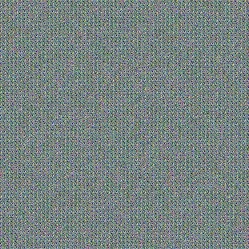

In [22]:
display(Image("0.png"))

Processing filter 0
Processing filter 1
Processing filter 2
Processing filter 3
Processing filter 4
Processing filter 5
Processing filter 6
Processing filter 7
Processing filter 8
Processing filter 9
Processing filter 10
Processing filter 11
Processing filter 12
Processing filter 13
Processing filter 14
Processing filter 15
Processing filter 16
Processing filter 17
Processing filter 18
Processing filter 19
Processing filter 20
Processing filter 21
Processing filter 22
Processing filter 23
Processing filter 24
Processing filter 25
Processing filter 26
Processing filter 27
Processing filter 28
Processing filter 29
Processing filter 30
Processing filter 31
Processing filter 32
Processing filter 33
Processing filter 34
Processing filter 35
Processing filter 36
Processing filter 37
Processing filter 38
Processing filter 39
Processing filter 40
Processing filter 41
Processing filter 42
Processing filter 43
Processing filter 44
Processing filter 45
Processing filter 46
Processing filter 47
Pr

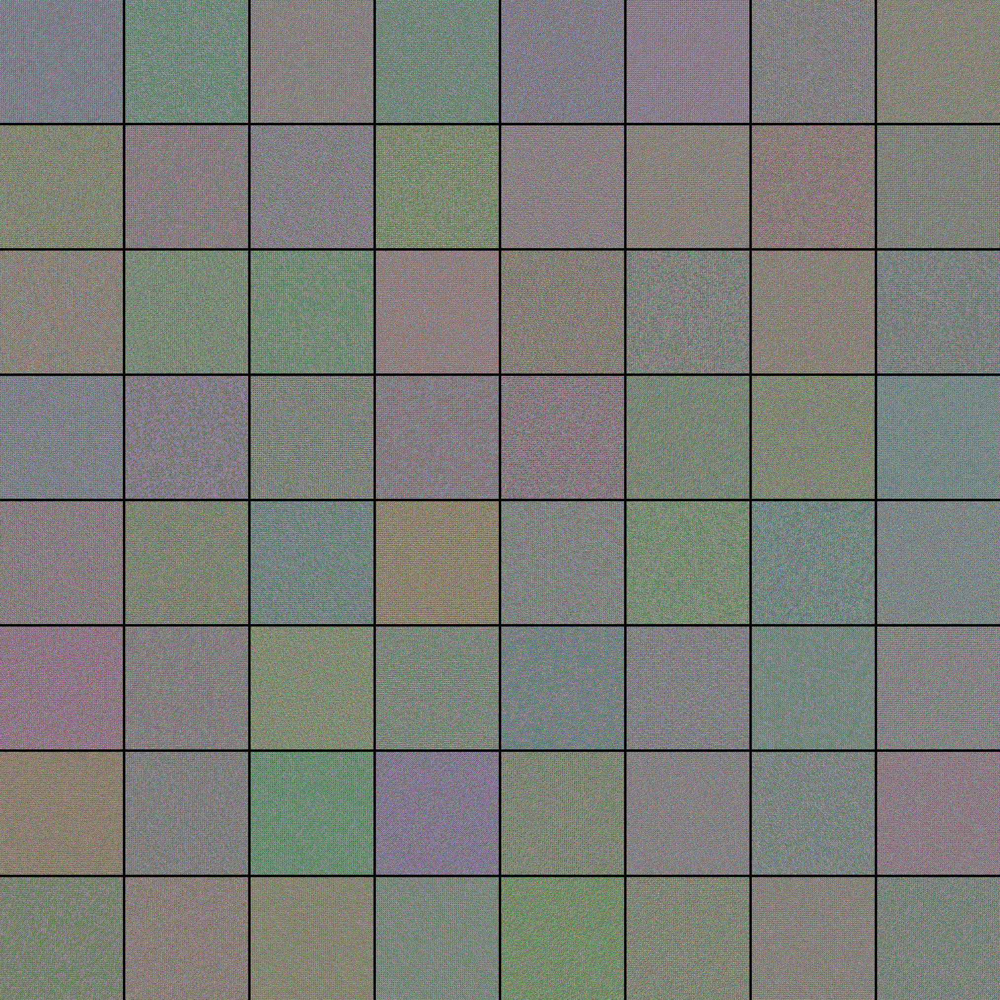

In [23]:
# Compute image inputs that maximize per-filter activations
# for the first 64 filters of our target layer
all_imgs = []
for filter_index in range(64):
    print("Processing filter %d" % (filter_index, ))
    loss, img = visualize_filter(filter_index)
    all_imgs.append(img)

# Build a black picture with enough space for
# our 8 x 8 filters of size 128 x 128, with a 5px margin in between
margin = 5
n = 8
cropped_width = img_width - 25 * 2
cropped_height = img_height - 25 * 2
width = n * cropped_width + (n - 1) * margin
height = n * cropped_height + (n - 1) * margin
stitched_filters = np.zeros((width, height, 3))

# Fill the picture with our saved filters
for i in range(n):
    for j in range(n):
        img = all_imgs[i * n + j]
        stitched_filters[(cropped_width + margin) *
                         i:(cropped_width + margin) * i + cropped_width,
                         (cropped_height + margin) *
                         j:(cropped_height + margin) * j +
                         cropped_height, :, ] = img

keras.preprocessing.image.save_img("stiched_filters.png", stitched_filters)
display(Image("stiched_filters.png"))